In [1]:
import torch
from PIL import Image
from torch.nn import functional as F
import os
import time
import cv2
from face_model.gpen_model import FullGenerator

In [2]:
from torchvision import utils, transforms
topil = transforms.ToPILImage()
model_state = torch.load('/home/wizard/buckets/bsp-ai-science-scratch/nicg/checkpoints/smilification/2000-noise/020000.pth')
model = FullGenerator(1024, 512, 8).cuda()
model.load_state_dict(model_state['g_ema'])

SAVE_TEMP_PATH = '/home/wizard/GPEN-smile/temp'

In [3]:
from production.remini.app.handler import ReminiEnhanceHandler, Request
from production.remini.app.main import setup_model
def make_model() -> ReminiEnhanceHandler:
    print("\n⌛️ Loading model... ")
    handler = setup_model()
    print("✅ Model loaded!\n\n")
    return handler
def process_img(model, img_path):
    request = Request(
            input_path=img_path,
            output_path='/home/wizard/GPEN-smile/temp/temp_remini',
            enhance_config="enhance-a",
            output_format="image/jpeg",
            pipeline_config="production",
            edit_mode='latent_mapper',
            edit_strength=1.0,
            edit_choice='Attractive',
            edit_enabled=False,
        )
    response = model.inference(request)
    return Image.open(response.enhanced_image_path)
remini_model = make_model()



⌛️ Loading model... 


/home/wizard/miniconda/envs/bendai/lib/python3.9/site-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1646756402876/work/aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


✅ Model loaded!




/home/wizard/miniconda/envs/bendai/lib/python3.9/site-packages/torchvision/utils.py:63: UserWarning: The parameter 'range' is deprecated since 0.12 and will be removed in 0.14. Please use 'value_range' instead.
  warnings.warn(
/home/wizard/miniconda/envs/bendai/lib/python3.9/site-packages/torch/nn/functional.py:3704: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")


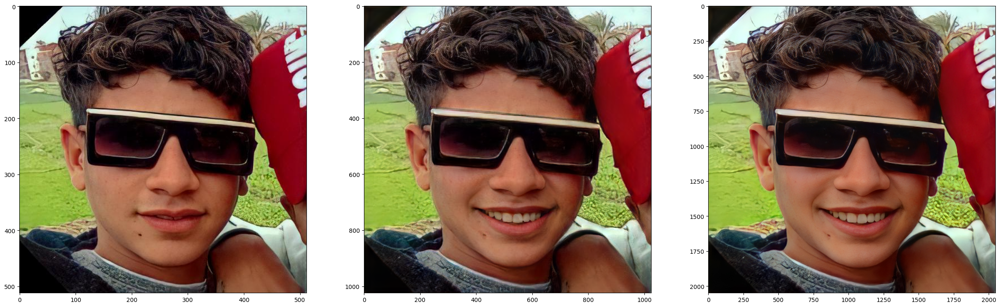

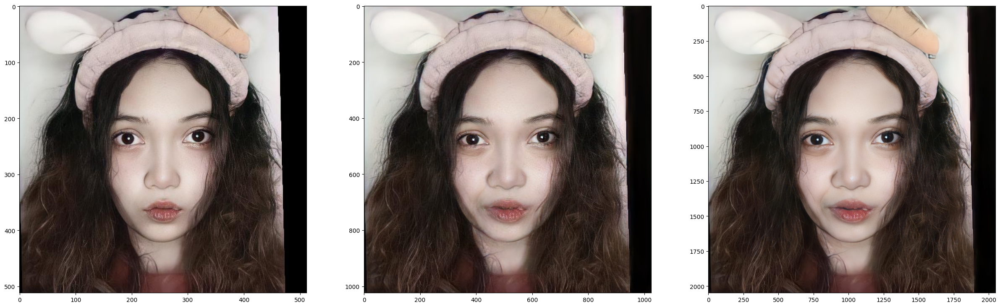

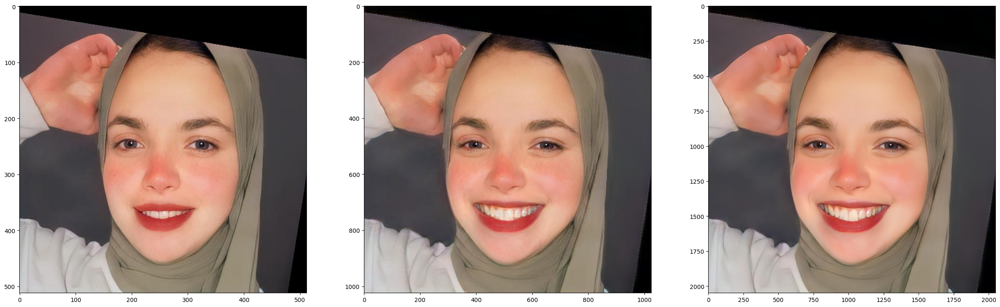

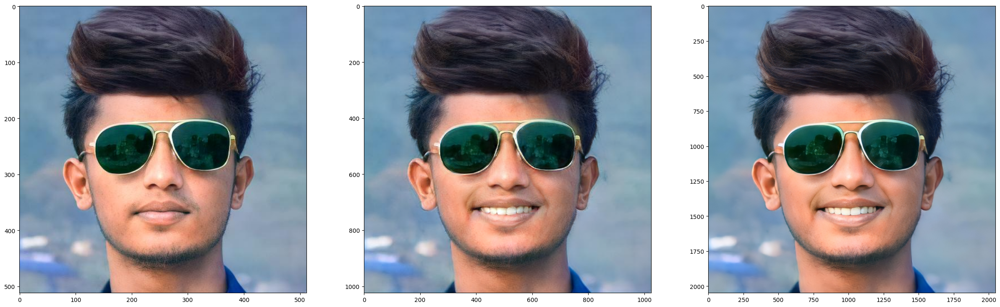

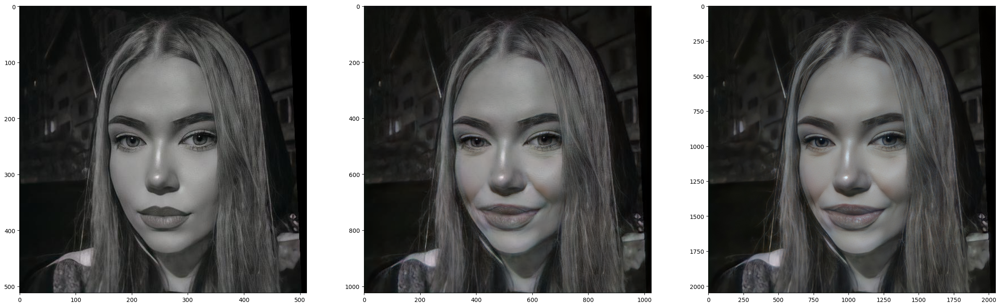

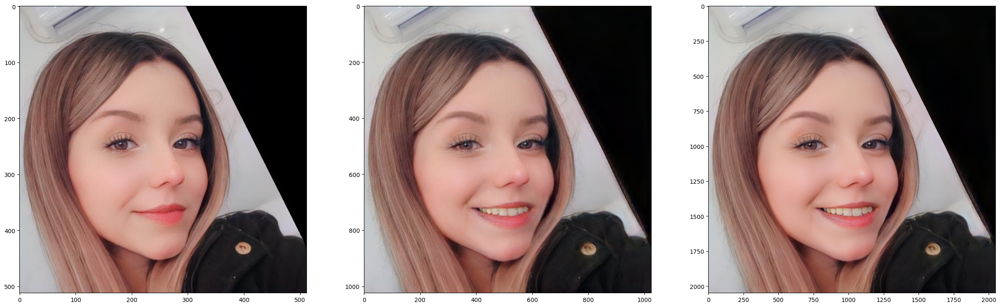

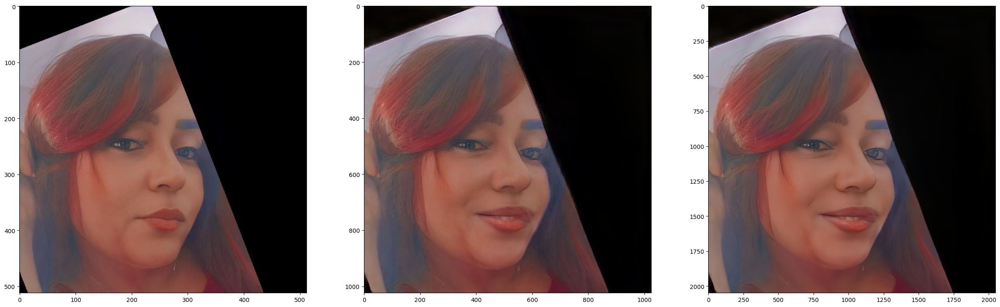

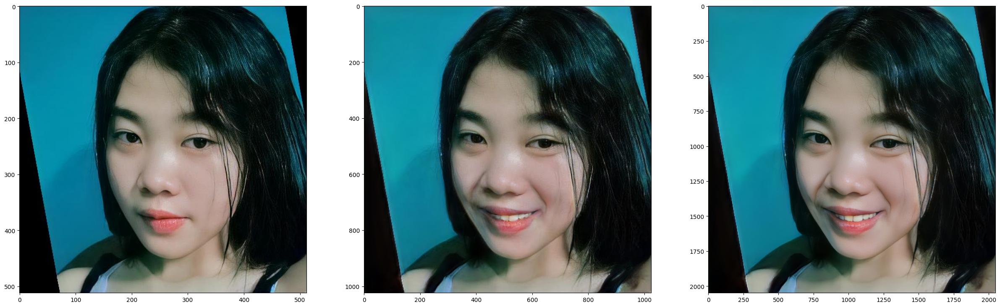

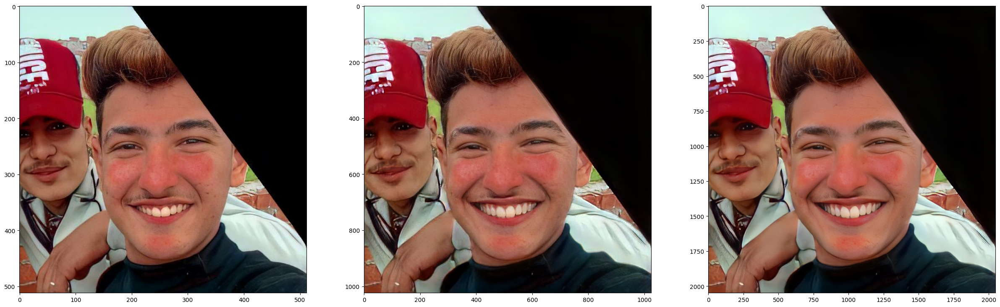

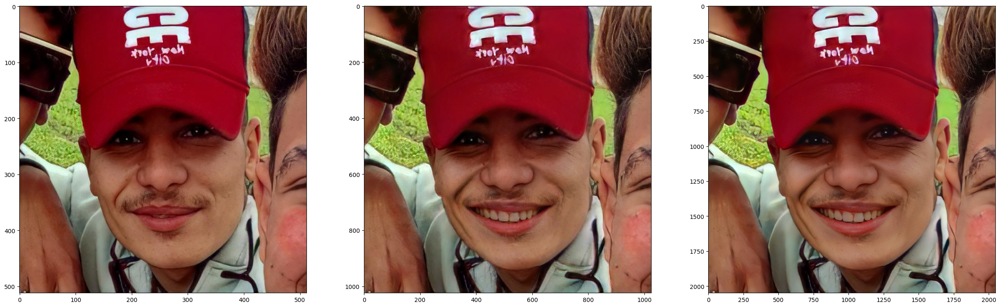

In [4]:
import matplotlib.pyplot as plt
dir = '/home/wizard/GPEN-smile/examples/remini-small'
imgs = []

for img_path in [os.path.join(dir, i) for i in os.listdir(dir)]:
    input = cv2.imread(img_path, cv2.IMREAD_COLOR)
    input_orig = cv2.cvtColor(input, cv2.COLOR_BGR2RGB)
    input = torch.from_numpy(input).cuda().permute(2, 0, 1).unsqueeze(0)
    img_t = (input/255.-0.5)/0.5
    img_t = F.interpolate(img_t, (1024, 1024))
    img_t = torch.flip(img_t, [1])
    output, _ = model(img_t, 15000)
    grid = utils.make_grid(
                                    output,
                                    nrow=1,
                                    normalize=True,
                                    range=(-1, 1),
                                )
    topil(grid.cpu()).save(os.path.join(SAVE_TEMP_PATH, img_path.split('/')[-1]))
    remini_output = process_img(remini_model, os.path.join(SAVE_TEMP_PATH, img_path.split('/')[-1]))
    fig, axs = plt.subplots(1, 3, figsize = (30,10))
    axs[0].imshow(input_orig)
    axs[1].imshow(topil(grid.cpu()))
    axs[2].imshow(remini_output)
    plt.show()
    del input, img_t, grid, remini_output

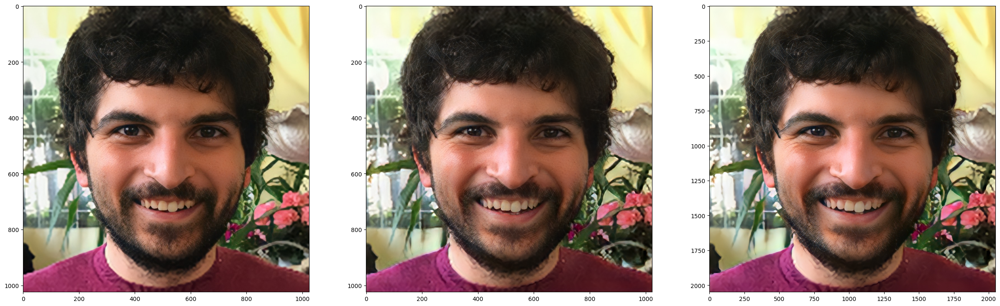

In [5]:
img_path = '/home/wizard/GPEN-smile/examples/orig.png'
input = cv2.imread(img_path, cv2.IMREAD_COLOR)
input_orig = cv2.cvtColor(input, cv2.COLOR_BGR2RGB)
input = torch.from_numpy(input).cuda().permute(2, 0, 1).unsqueeze(0)
img_t = (input/255.-0.5)/0.5
img_t = F.interpolate(img_t, (1024, 1024))
img_t = torch.flip(img_t, [1])
output, _ = model(img_t, 15000)
grid = utils.make_grid(
                                output,
                                nrow=1,
                                normalize=True,
                                range=(-1, 1),
                            )
topil(grid.cpu()).save(os.path.join(SAVE_TEMP_PATH, img_path.split('/')[-1]))
remini_output = process_img(remini_model, os.path.join(SAVE_TEMP_PATH, img_path.split('/')[-1]))

fig, axs = plt.subplots(1, 3, figsize = (30,10)) 
axs[0].imshow(input_orig)
axs[1].imshow(topil(grid.cpu()))
axs[2].imshow(remini_output)
plt.show()